# Option Pricing

El objetivo es utilizar modelos de aprendizaje supervisado para el precing de opciones.

## **Contenido**
1. Definir del problema
2. Cargar herramientas
3. Preparar data
4. EDA y Feature engineering
5. Evaluar modelos
6. Tuning
7. Testing


# 1. Definir el problema

La variable a predecir es el precio de la opción y las variables predictoras son los datos de mercado que se utilizan como insumos para la formula de Black-Scholes.

Formula Black Scholes:

$$ C = Se^{-q \tau}N(d_1) - Ke^{-r \tau}N(d_2) \, $$

con

$$  d_1 = \frac{\ln(S/K) + (r - q + \sigma^2/2)\tau}{\sigma\sqrt{\tau}}; ~~~~~ d_2 = d_1 - \sigma\sqrt{\tau}$$

Donde:
- $S$: Precio del subyacente
- $K$: Strike price
- $\tau$: Time to maturity
- $r$: Tasa libre de riesgo
- $q$: Rentabilidad por dividendo
- $\sigma$: Volatilidad 

Una definicion instrumental comun es definir el *Moneyness* como $M = K/S$. Para este ejemplo, ademas se asume que el subyacente no paga divi $q=0$. Asi, la ecuacion de Black-Scholes queda definida por:

$$C =  e^{-q \tau}N\left( \frac{- \ln(M) + (r+ \sigma^2/2 )\tau}{\sigma\sqrt{\tau}}\right) - e^{-r \tau} MN\left( \frac{- \ln(M) + (r - \sigma^2/2)\tau}{\sigma\sqrt{\tau}} \right) \, $$

### Definicion de la volatilidad
En general, la volatilidad depende del *moneyness* [volatility smiles](https://en.wikipedia.org/wiki/Volatility_smile) y el *time to maturity*. En la practica, los indicadores de volatilidad se obtienen de proveedores. Para este ejercicio se asume la siguiente [forma funcional](https://link.springer.com/content/pdf/10.1007/s11147-020-09166-0.pdf): 

$$ \sigma(M, \tau) = \sigma_0 + \alpha\tau + \beta (M - 1)^2$$

# 2. Cargar herramientas

In [1]:
# distribuciones estadisticas
from scipy.stats import norm

# funciones matematicas
import numpy as np

# trabajo con tablas
import pandas as pd
import pandas_datareader.data as web

# graficos
from pandas.plotting import scatter_matrix
from statsmodels.graphics.tsaplots import plot_acf
import matplotlib.pyplot as plt
import seaborn as sns

# modelamiento: preprocesamiento
from sklearn.preprocessing import StandardScaler

# modelamiento: cross-validation
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

# modelamiento: algoritmos basicos
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR

# modelamiento: algoritmos ensemble
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor

# modelos estadisticos
import statsmodels.api as sm

# guardar modelos
from pickle import dump
from pickle import load

# metricas de error (para evaluar performance)
from sklearn.metrics import mean_squared_error

# seleccion de features
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_regression


# **3. Generar data**
Prinero se define los parametros:

In [2]:
true_alpha = 0.1
true_beta = 0.1
true_sigma0 = 0.2
risk_free_rate = 0.05

Definimos funciones para generar  volatilidad de precion de opcion y precio:

In [3]:
def option_vol_from_surface(moneyness, time_to_maturity):
    return true_sigma0 + true_alpha * time_to_maturity + true_beta * np.square(moneyness - 1)

def option_price(moneyness, time_to_maturity, option_vol):
    d1=(np.log(1/moneyness)+(risk_free_rate+np.square(option_vol))*time_to_maturity)/(option_vol*np.sqrt(time_to_maturity))
    d2=(np.log(1/moneyness)+(risk_free_rate-np.square(option_vol))*time_to_maturity)/(option_vol*np.sqrt(time_to_maturity))
    N_d1 = norm.cdf(d1)
    N_d2 = norm.cdf(d2)
    return N_d1 - moneyness * np.exp(-risk_free_rate * time_to_maturity) * N_d2

Simular variables de mercado:

In [4]:
N = 10000

# moneyness
Ks = 1+0.25*np.random.randn(N)

# time to maturity
Ts = np.random.random(N)

# volatilidad
Sigmas = np.array([option_vol_from_surface(k,t) for k,t in zip(Ks,Ts)])

# precios
Ps = np.array([option_price(k,t,sig) for k,t,sig in zip(Ks,Ts,Sigmas)])

Finalmente formamos la tabla para modelamiento

In [5]:
Y = Ps
X = np.concatenate([Ks.reshape(-1,1), Ts.reshape(-1,1), Sigmas.reshape(-1,1)], axis=1)
dataset = pd.DataFrame(np.concatenate([Y.reshape(-1,1), X], axis=1), columns=['Price', 'Moneyness', 'Time', 'Vol'])

# 4. **Analisis exploratorio y feature engineering**

In [6]:
dataset.head()

,Price,Moneyness,Time,Vol
0,0.036765,1.163494,0.283108,0.230984
1,0.133843,0.992161,0.405060,0.240512
2,0.108495,1.133387,0.552702,0.257049
3,0.266323,0.932905,0.933696,0.293820
4,0.222661,0.829726,0.447445,0.247644


In [7]:
dataset.describe()

,Price,Moneyness,Time,Vol
count,10000.000000,10000.000000,10000.000000,10000.000000
mean,0.178624,0.998908,0.501745,0.256346
std,0.133983,0.248426,0.290796,0.030262
min,0.000000,0.117364,0.000266,0.200244
25%,0.076785,0.831912,0.247790,0.230900
50%,0.161270,0.997986,0.505421,0.256320
75%,0.253457,1.162928,0.753991,0.281565
max,0.884433,1.997867,0.999731,0.372228


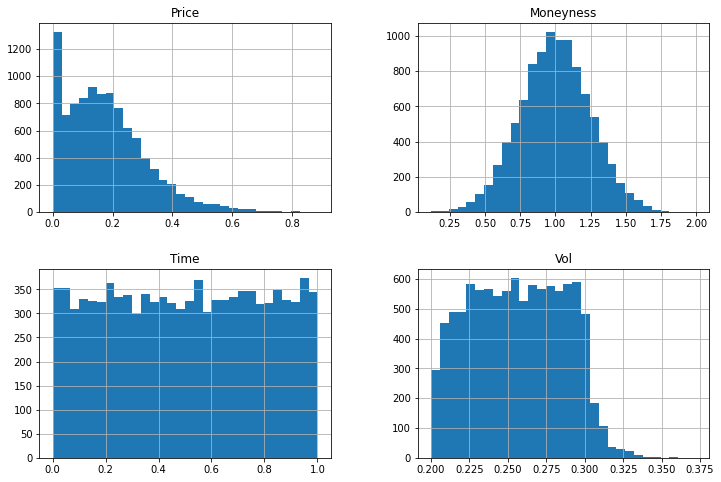

In [8]:
dataset.hist(bins=30, figsize=(12, 8))
plt.show()

Check de correlaciones

In [9]:
matriz_correlacion = dataset.corr()
print(type(matriz_correlacion))
matriz_correlacion

<class 'pandas.core.frame.DataFrame'>


,Price,Moneyness,Time,Vol
Price,1.000000,-0.864444,0.354789,0.428975
Moneyness,-0.864444,1.000000,0.015975,0.015192
Time,0.354789,0.015975,1.000000,0.958259
Vol,0.428975,0.015192,0.958259,1.000000


In [10]:
matriz_correlacion['Price']

Price        1.000000
Moneyness   -0.864444
Time         0.354789
Vol          0.428975
Name: Price, dtype: float64

<Figure size 1080x1080 with 0 Axes>

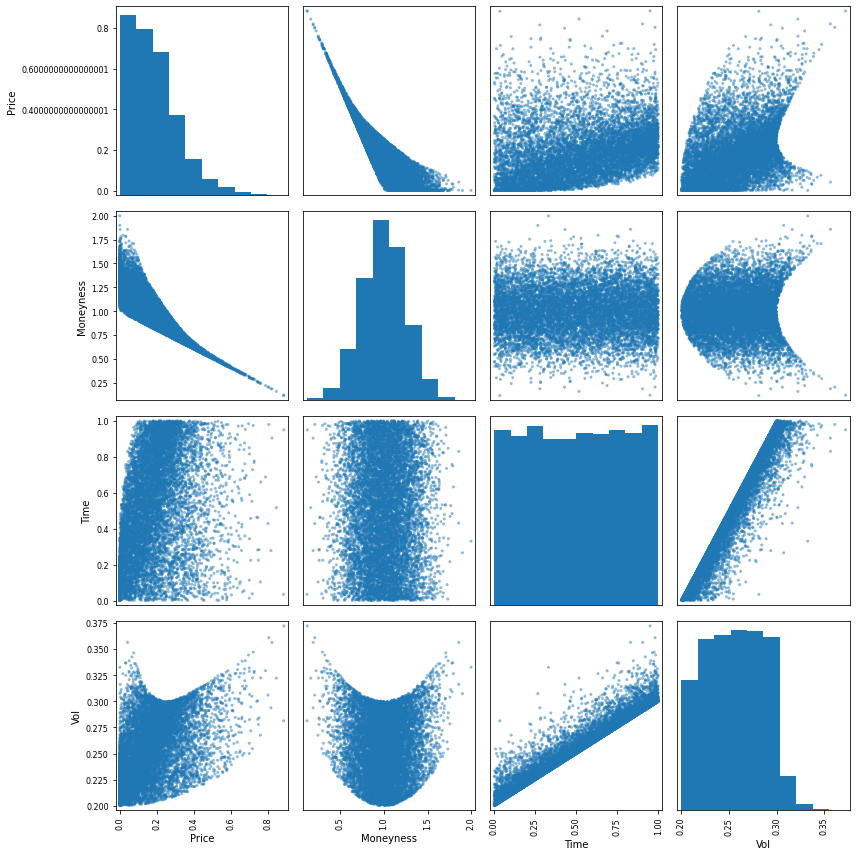

In [11]:
plt.figure(figsize=(15, 15))
scatter_matrix(dataset, figsize=(12, 12))
plt.tight_layout()

# 5. Evaluar modelos

## Train-Test split

In [12]:
validation_size = 0.2
train_size = int(len(X) * (1-validation_size))
X_train, X_test = X[0:train_size], X[train_size:len(X)]
Y_train, Y_test = Y[0:train_size], Y[train_size:len(X)]

In [13]:
num_folds = 10
seed = 7
scoring = 'neg_mean_squared_error' 

## Entrenar algoritmos

In [14]:
models = []
models.append(('LR', LinearRegression()))
models.append(('KNN', KNeighborsRegressor()))
models.append(('CART', DecisionTreeRegressor()))
models.append(('SVR', SVR()))
models.append(('ABR', AdaBoostRegressor()))
models.append(('GBR', GradientBoostingRegressor()))
models.append(('RFR', RandomForestRegressor()))

In [15]:
names = []
kfold_results = []
test_results = []
train_results = []
for name, model in models:
    names.append(name)
    kfold = KFold(n_splits=num_folds, random_state=seed, shuffle=True)
    # Convertir el error cuadratico a positivo (menos, mejor)
    cv_results = -1* cross_val_score(model, X_train, Y_train, cv=kfold, scoring=scoring)
    kfold_results.append(cv_results)
    msg = "%s: %f (%f) " % (name, cv_results.mean(), cv_results.std())
    print(msg)

LR: 0.000359 (0.000021) 
KNN: 0.000019 (0.000015) 
CART: 0.000010 (0.000001) 
SVR: 0.004671 (0.000212) 
ABR: 0.000668 (0.000032) 
GBR: 0.000018 (0.000003) 
RFR: 0.000002 (0.000002) 


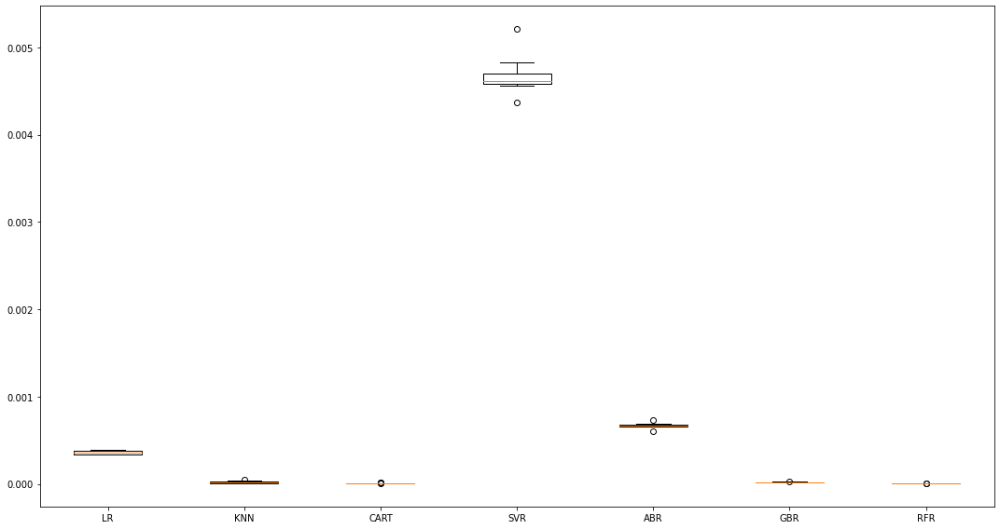

In [16]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.boxplot(kfold_results)
ax.set_xticklabels(names)
fig.set_size_inches(15,8)
plt.tight_layout()

# 6. Tuning

In [17]:
# Grid Search: Random Forest
"""
n_estimators : int (default=100)
    Numero de arboles. 
""" 
model = RandomForestRegressor()
n_estimators = [10, 50, 100, 200]
param_grid = dict(n_estimators=n_estimators)

kfold = KFold(n_splits=num_folds, random_state=seed, shuffle=True)
grid = GridSearchCV(estimator=model, param_grid=param_grid, scoring=scoring, cv=kfold)
grid_result = grid.fit(X_train, Y_train)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: -0.000002 using {'n_estimators': 200}
-0.000004 (0.000002) with: {'n_estimators': 10}
-0.000003 (0.000001) with: {'n_estimators': 50}
-0.000002 (0.000002) with: {'n_estimators': 100}
-0.000002 (0.000002) with: {'n_estimators': 200}


In [18]:
# prepare model
modelo_final = RandomForestRegressor(n_estimators=(200))
modelo_final.fit(X_train, Y_train)

RandomForestRegressor(n_estimators=200)

# **7. Testing**

In [19]:
# mse en data de testing
predictions = modelo_final.predict(X_test)
print(mean_squared_error(Y_test, predictions))

2.574600778493728e-06


El error estan en un orden por debajo de milesimas de dolar. Buen performance. El RF pudo capturar las relaciones lineales y nolineales de las variables de mercado que afectan el precio de las opciones.